# Comparator Circuit Analysis

This notebook is for finding correct operating points for a JPM-SFQ circuit based on a flux comparator. 

In [1]:
import sys
sys.path.append('/mnt/labshare/Programs/python/HelperFunctions/')
from myfunctions import *
from plottingFunctions import *
from scipy import io as scio
from scipy.stats import uniform, norm
from scipy import optimize
import re
import subprocess
import tqdm

## WRspice Circuit

Based on circuit from Tom Ohki, with standard JPM parameters:

```
* Generated by Xic from cell root
.tran 1p 20n
.model jjs jj(rtype=1, icrit=1u, vshunt=90u, cap=40f)
.options ysep
.temp -272
BB 3 0 13 jjs area=100
BE1 6 2 10 jjs area=100
BE2 6 0 11 jjs area=100
BQ 8 0 14 jjs area=25
BT 2 3 12 jjs area=100
IBS 0 3 45u
IRABI 4 0 pulse -.75u 0.75u 0 5p 5p 2.5n 5n
IT 0 2 75u
K1 LJPM LC 0.05
LC 3 8 60p
LJPM 4 0 1n
V0 1 0 gpulse 0 0 20p 3.6p .5n
X0 1 5 JTL
X1 5 6 JTL
X2 3 7 JTL
X3 7 9 JTL
.subckt JTL 4 5
B0 2 0 6 jjs area=100
B1 3 0 7 jjs area=100
I0 0 1 150u
LT0 4 2 5p
LT1 2 1 5p
LT2 1 3 5p
LT3 3 5 5p
.ends JTL

.control
run
plot tran LJPM#branch v(1) v(3.x0) v(3.x1) LC#branch v(3) v(3.x3)
write cmp.dat v(1) v(3.X3)
.endc
```

want to adjust

- comparator $I_c$ / area (j1, j2, jq)
- coupling mutual (k1)
- JPM current amplitude (i1)

want to analyze

- Locating operating bias points $I_{b1}$ and $I_{b2}$, if they exist
- Finding range of operating bias points
- Performing a Monte Carlo simulation on comparator parameters to determine circuit robustness.

In [2]:
def gen_cir(cirfile='cmp.cir', jt=100, jb=100, jq=25, ib1=75, ib2=45, lc=60,k1=0.05, i1=0.75, outfile='cmp.wrdata'):
    
    cir_str = """* Generated by Xic from cell root
.tran 1p 5n
.model jjs jj(rtype=1, icrit=1u, vshunt=90u, cap=40f)
.options ysep
.temp -272
BE1 6 2 10 jjs area=100
BE2 6 0 11 jjs area=100
BT 2 3 12 jjs area={}
BB 3 0 13 jjs area={}
BQ 8 0 14 jjs area={}
IT 0 2 {}u
IB 0 3 {}u
LC 3 8 {}p
K1 LJPM LC {}
IRABI 4 0 pulse -{}u {}u 0 5p 5p 2.5n 5n
LJPM 4 0 1n
V0 1 0 gpulse 0 0 20p 3.6p .5n
X0 1 5 JTL
X1 5 6 JTL
X2 3 7 JTL
X3 7 9 JTL
.subckt JTL 4 5
B0 2 0 6 jjs area=100
B1 3 0 7 jjs area=100
I0 0 1 150u
LT0 4 2 5p
LT1 2 1 5p
LT2 1 3 5p
LT3 3 5 5p
.ends JTL
.control
run
*plot tran LJPM#branch v(1) v(3.x0) v(3.x1) LC#branch v(3) v(3.x3)
write {} LJPM#branch LC#branch v(1) v(3.X3) v(7.X0)/2/pi v(7.X3)/2/pi
.endc
""".format(jt, jb, jq, ib1, ib2, lc, k1, i1, i1, outfile)
    
    with open(cirfile, 'w') as f:
        f.write(cir_str)
    
    return cir_str

def gen_random_cir(ib1, ib2, sigma=0.1):
    
    params = dict(
        jt = 100,
        jb = 100,
        jq = 25,
        k1 = 0.05,
        lc = 60,
        i1 = 0.75
    )
    new_params = {}

    for key in params:
        new_params[key] = params[key]*norm(loc=1, scale=sigma).rvs()
    
    gen_cir(ib1, ib2, **new_params)

def run_wrspice(infile, outfile):
    subprocess.run(['wrspice', '-b', infile])
    return getWRData(outfile)

def wrspice_to_matlab(datafile, save=True):

    datastruct = getWRData(datafile)
    
    pathname, filename = path.split(datafile)

    for key in datastruct.keys():
        newkey = key.replace('(', '')
        newkey = newkey.replace(')', '')
        newkey = re.sub('[^0-9a-zA-Z]+', '_', newkey)
        datastruct[newkey] = datastruct.pop(key)

    for i, var in enumerate(datastruct['dataNames']):
        newvar = var.replace('(','').replace(')', '')
        newvar = re.sub('[^0-9a-zA-Z]+', '_', newvar)
        datastruct['dataNames'][i] = newvar

    datastruct['NumVariables'] = datastruct.pop('No. Variables')
    datastruct['NumPoints'] = datastruct.pop('No. Points')

    outputfile = filename.split('.')[0] + '.mat'
    
    if save:
        scio.savemat(path.join(pathname, outputfile), datastruct)
        print('{} written to {}'.format(outputfile, pathname))

    return datastruct

In [3]:
gen_cir(jt=100);

In [4]:
def find_bias_pts(**kwargs):
    works = 0
    ib1s = np.linspace(60, 80, 11)
    ib2s = np.linspace(40, 50, 11)
    z = []
    for ib1 in tqdm.tqdm_notebook(ib1s):
        z.append([])
        for ib2 in ib2s:
            gen_cir(ib1=ib1, ib2=ib2, **kwargs)
            data = run_wrspice('cmp.cir', 'cmp.wrdata')

            vin = np.squeeze(data['v(7.X0)'])[-1]
            vout = np.squeeze(data['v(7.X3)'])[-1]

            vavg = vout/vin
            z[-1].append(vavg)

            if vavg > 0.4 and vavg < 0.6:
                print("Found operating point at Ib1 = {}uA, Ib2 = {}uA".format(ib1, ib2))
                works += 1 
    #         else:
    #             print("Ib1 = {}uA, Ib2 = {}uA, <v> = {}".format(ib1, ib2, vavg))
    
    layoutOpts = dict(width=500, height=500,
                     xaxis=dict(title='Ib2 (uA)'),
                     yaxis=dict(title='Ib1 (uA)'))
    HeatmapPlot(x=ib2s, y=ib1s, z=z, layoutOpts=layoutOpts);
    
    return ib1s, ib2s, z, works

In [5]:
data = run_wrspice('cmp.cir', 'cmp.wrdata')

In [6]:
data

{'Command': 'version 4.3.1',
 'Date': 'Thu Mar 28 17:00:01 2019',
 'Dimensions': array([   1, 5001]),
 'Flags': 'real',
 'LC#branch': array([[  0.00000000e+00,   5.12293878e-08,   4.60668192e-07, ...,
           3.46406917e-06,   3.46406917e-06,   3.46406917e-06]]),
 'LJPM#branch': array([[  0.00000000e+00,   4.50000000e-07,   1.50000000e-07, ...,
           7.50000000e-07,   7.50000000e-07,   7.50000000e-07]]),
 'No. Points': 5001.0,
 'No. Variables': 7.0,
 'Plotname': 'Transient analysis',
 'Title': 'CKT1',
 'Variables': '',
 'dataNames': ['time',
  'LC#branch',
  'LJPM#branch',
  'v(1)',
  'v(3.X3)',
  'v(7.X0)/2/pi',
  'v(7.X3)/2/pi'],
 'dataUnits': ['S', 'A', 'A', 'V', 'V', 'V', 'V'],
 'time': array([[  0.00000000e+00,   1.00000000e-12,   2.00000000e-12, ...,
           4.99800000e-09,   4.99900000e-09,   5.00000000e-09]]),
 'v(1)': array([[  1.27787240e-17,   4.63651275e-16,   1.02582306e-14, ...,
           2.58509575e-20,   6.75919956e-19,   1.27787240e-17]]),
 'v(3.X3)': array

In [9]:
ib1s, ib2s, z, num = find_bias_pts(jt=102, jb=99, jq=20);

A Jupyter Widget

KeyError: 'v(7.X0)'

## Margin Analysis

We want to ensure valid operating points at wide spread in junction critical current densities

In [10]:
def verify_scaled_circuit(target_params, xj=0, show=True, plot=False):
    new_params = {}

    for key in target_params:
        new_params[key] = target_params[key]*(1 + xj)
    
    print(new_params)
    
    works = 0
    
    ib1s = np.linspace(50, 80, 51)
    ib2s = np.linspace(40, 60, 51)
    
    for ib1 in ib1s:
        for ib2 in ib2s:
            gen_cir(ib1=ib1, ib2=ib2, **new_params)
            data = run_wrspice('cmp.cir', 'cmp.wrdata')
            
            time = np.squeeze(data['time'])
            ijpm = np.squeeze(data['LJPM#branch'])
            pin = np.squeeze(data['v(7.X0)/2/pi'])
            pout = np.squeeze(data['v(7.X3)/2/pi'])
            vout = np.squeeze(data['v(3.X3)'])

            pavg = pout[-1]/pin[-1]

            if pavg > 0.4 and pavg < 0.6 and (pout[int(len(pout)/2)] < 1):
                if show:
                    print("Found operating point at Ib1 = {}uA, Ib2 = {}uA".format(ib1, ib2))
                if plot:
                    LinePlot(x=time, y=ijpm)
                    LinePlot(x=time, y=vout)
                works += 1 
                break

#             else:
#                 if show:
#                     print("Ib1 = {}uA, Ib2 = {}uA, <v> = {}".format(ib1, ib2, vavg))
        if works > 0:
            break    
            
    new_params['ib1'] = ib1
    new_params['ib2'] = ib2
    return new_params, works



{'jt': 70.0, 'jb': 70.0, 'jq': 15.0, 'lc': 20.0, 'k1': 0.09}
Found operating point at Ib1 = 53.6uA, Ib2 = 54.8uA


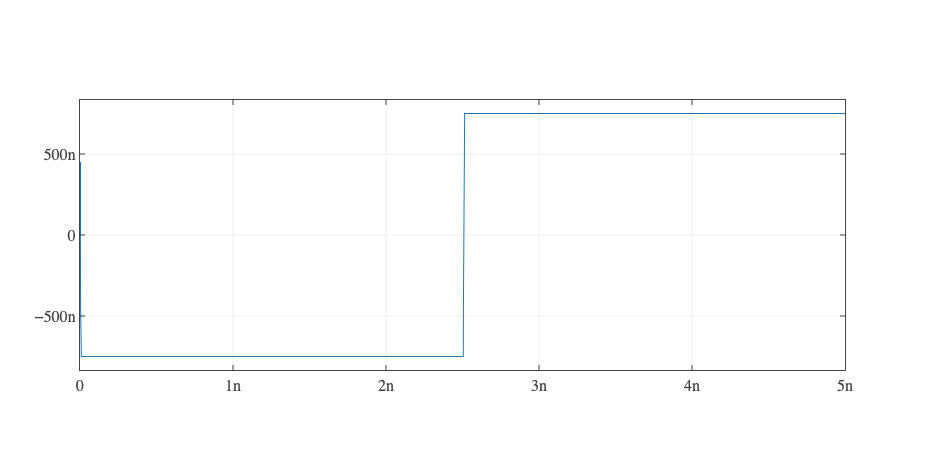

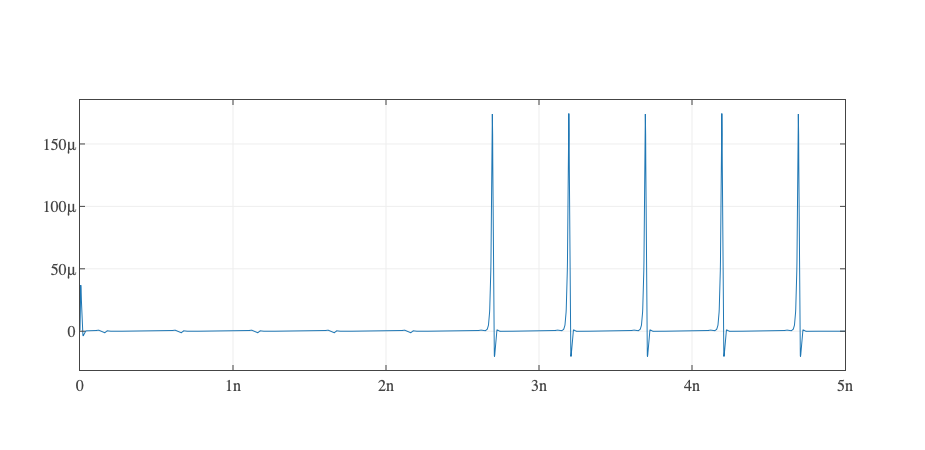

In [11]:
verify_scaled_circuit(dict(jt=70, jb=70, jq=15, lc=20, k1=0.09), xj=0.0, plot=True);

In [175]:
def perform_margin_analysis(target_params, max_xj):
    
    for xj in tqdm.tqdm_notebook(np.linspace(-max_xj, max_xj, 5)):
        
        new_params, works = verify_scaled_circuit(target_params, xj)
        if works:
            print("Circuit works -- xj = {}".format(xj))
        else:
            print("Circuit doesn't work -- xj = {}".format(xj))

In [176]:
perform_margin_analysis(dict(jt=70, jb=70, jq=15), 0.3)

A Jupyter Widget

Found operating point at Ib1 = 59.0uA, Ib2 = 50.0uA
Circuit works -- xj = -0.3
Found operating point at Ib1 = 57.5uA, Ib2 = 49.0uA
Circuit works -- xj = -0.15
Found operating point at Ib1 = 56.0uA, Ib2 = 48.0uA
Circuit works -- xj = 0.0
Found operating point at Ib1 = 57.5uA, Ib2 = 47.0uA
Circuit works -- xj = 0.14999999999999997
Found operating point at Ib1 = 62.0uA, Ib2 = 46.0uA
Circuit works -- xj = 0.3


In [ ]:
# Find negative margin

# Start at negative max

max_xj = 0.3

stop = False
step = .1
min_step = .01

xj = max_xj

while ~stop:
    
    new_params, works = verify_scaled_circuit(target_params, xj)
    
    if works:
        if xj == max_xj or :
        break
        
    else:
        step = 
    

# Find positive margin

## Monte Carlo margin analysis

Want to run simulation with some spread in parameters [-xm, +xm], and verify that operating bias points exist at every point.

In [8]:
params = dict(
    jt = 100,
    jb = 100,
    jq = 25,
    k1 = 0.05,
    i1 = 0.75
)

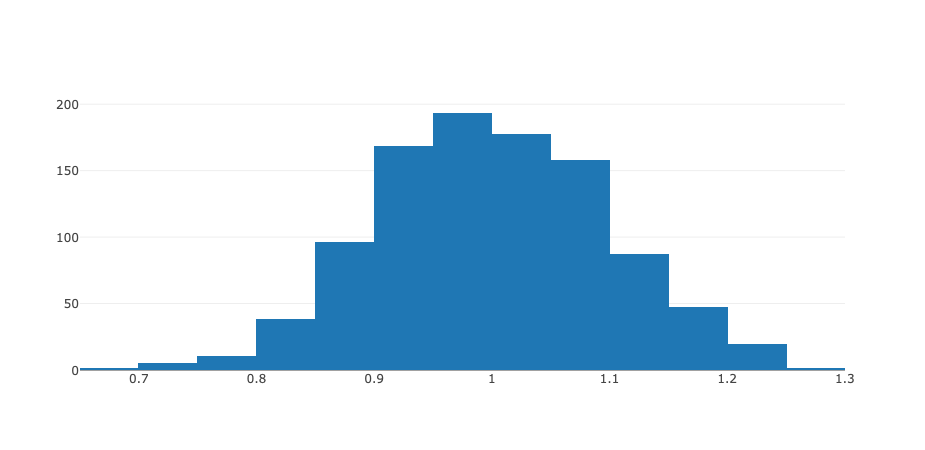

In [184]:
iplot([go.Histogram(x = norm(loc=1, scale=0.1).rvs(1000), nbinsx=20)])

In [81]:
def verify_random_cir(target_params, sigma=0.1, show=False):
    
    new_params = {}

    for key in target_params:
        new_params[key] = params[key]*norm(loc=1, scale=sigma).rvs()
#         new_params[key] = round(target_params[key]*uniform(loc=1-sigma, scale=2*sigma).rvs(), 3)
    
#     print(new_params)
    
    works = 0
    
    ib1s = np.linspace(60, 80, 11)
    ib2s = np.linspace(40, 50, 11)
    z = []
    
    for ib1 in ib1s:
        z.append([])
        for ib2 in ib2s:
            gen_cir(ib1=ib1, ib2=ib2, **new_params)
            data = run_wrspice('cmp.cir', 'cmp.wrdata')

            vin = np.squeeze(data['v(7.X0)'])[-1]
            vout = np.squeeze(data['v(7.X3)'])[-1]

            vavg = vout/vin
            z[-1].append(vavg)

            if vavg > 0.4 and vavg < 0.6:
                if show:
                    print("Found operating point at Ib1 = {}uA, Ib2 = {}uA".format(ib1, ib2))
                works += 1 
                break

#             else:
#                 if show:
#                     print("Ib1 = {}uA, Ib2 = {}uA, <v> = {}".format(ib1, ib2, vavg))
        if works > 0:
            break    
    return new_params, works

# verify_random_cir(sigma=0.05)

In [83]:
def perform_mc_analysis(target_params, num=100, sigma=0.05, show=False):
    valid_pts = 0

    for i in tqdm.tnrange(num):

        new_params, num_pts = verify_random_cir(target_params, sigma=sigma, show=show)

        if num_pts > 0:
            valid_pts += 1
        else:
            if show:
                print("No operating point found for {}".format(new_params))

    success_rate = valid_pts/num
    if show: 
        print("Found operating points in {} of {} trials -- {:.3f} %".format(valid_pts, num, 100*success_rate))
        
    return 1 - success_rate

In [84]:
params = dict(
    jt = 100,
    jb = 100,
    jq = 25,
    k1 = 0.05,
    i1 = 0.75
)

perform_mc_analysis(params, num=5, sigma=0.1, show=True)

A Jupyter Widget

No operating point found for {'jt': 114.69649151144662, 'jb': 104.42813052204809, 'jq': 21.566130346141215, 'k1': 0.044801001237291908, 'i1': 0.85800010138115401}
No operating point found for {'jt': 108.68779882643751, 'jb': 103.55866051979665, 'jq': 26.351333565699132, 'k1': 0.056710244332039167, 'i1': 0.75806606764501561}
No operating point found for {'jt': 99.770704404581522, 'jb': 110.70779759555853, 'jq': 21.71995539735067, 'k1': 0.042627934848151472, 'i1': 0.69455826830826273}
No operating point found for {'jt': 101.97683511335708, 'jb': 115.46326294397653, 'jq': 31.601910504927595, 'k1': 0.042291026873195796, 'i1': 0.75325010605101494}
No operating point found for {'jt': 100.88943308203764, 'jb': 95.005588423292551, 'jq': 19.852459450680204, 'k1': 0.040348455028136131, 'i1': 0.68083375972275761}
Found operating points in 0 of 5 trials -- 0.000 %


1.0

## Nelder-Mead optimization

Want to find optimal target parameters to improve yield

Starting target values:

- $J_t = 100 \mu A$
- $J_b = 100 \mu A$
- $J_q = 25 \mu A$

In [86]:
def yield_function(target_params):
    keys = ['jt', 'jb', 'jq']
    
    params = {}
    
    for i, key in enumerate(keys):
        params[key] = target_params[i]
        
#     print(params)
    
    return perform_mc_analysis(params, num=5, sigma=0.2, show=False)
    
yield_function([100, 100, 25])

A Jupyter Widget

0.8

In [87]:
init_target_params = [100, 100, 25]

In [88]:
optimize.fmin(yield_function, init_target_params, maxiter=10, full_output=True)

A Jupyter Widget

A Jupyter Widget

A Jupyter Widget

A Jupyter Widget

A Jupyter Widget

A Jupyter Widget

A Jupyter Widget

A Jupyter Widget

A Jupyter Widget

A Jupyter Widget

A Jupyter Widget

A Jupyter Widget

A Jupyter Widget

A Jupyter Widget

A Jupyter Widget

A Jupyter Widget

A Jupyter Widget

A Jupyter Widget

A Jupyter Widget

A Jupyter Widget

A Jupyter Widget

A Jupyter Widget

A Jupyter Widget

A Jupyter Widget

A Jupyter Widget

A Jupyter Widget

A Jupyter Widget

A Jupyter Widget

A Jupyter Widget

A Jupyter Widget

A Jupyter Widget

A Jupyter Widget

A Jupyter Widget

A Jupyter Widget

A Jupyter Widget

(array([ 100.078125  ,  104.765625  ,   25.01953125]),
 0.40000000000000002,
 10,
 37,
 2)

In [121]:
yield_function([100, 105, 25])

A Jupyter Widget

0.8

# Switching Probabilities

In [43]:
def gen_sp_cir(cirfile='cmp_sp.cir', jt=100, jb=100, jq=25, ib1=75, ib2=45, lc=60,k1=0.05, ix=1, iq=87, outfile='cmp_sp.wrdata'):
    
    cir_str = f"""* Generated by Xic from cell root
.tran 5p 25n
.model jjs jj(rtype=1, icrit=1u, vshunt=90u, cap=40f)
.options ysep
.temp -272
BE1 6 2 10 jjs area=100
BE2 6 0 11 jjs area=100
BT 2 3 12 jjs area={jt}
BB 3 0 13 jjs area={jb}
BQ 8 0 14 jjs area={jq}
IT 0 2 {ib1}u
IB 0 3 {ib2}u
Iq 6 3 gauss {iq}n 0 0
LC 3 8 {lc}p
K1 LJPM LC {k1}
IJPM 4 0 {ix}u
LJPM 4 0 1n
V0 1 0 gpulse 0 0 20p 3.6p .25n
X0 1 5 JTL
X1 5 6 JTL
X2 3 7 JTL
X3 7 9 JTL
.subckt JTL 4 5
B0 2 0 6 jjs area=100
B1 3 0 7 jjs area=100
I0 0 1 150u
LT0 4 2 5p
LT1 2 1 5p
LT2 1 3 5p
LT3 3 5 5p
.ends JTL
.control
run
*plot tran LJPM#branch v(1) v(3.x0) v(3.x1) LC#branch v(3) v(3.x3)
write {outfile} LJPM#branch LC#branch v(1) v(3.X0) v(3.X3) v(7.X0)/2/pi v(7.X3)/2/pi
.endc
""" 
    with open(cirfile, 'w') as f:
        f.write(cir_str)
    
    return cir_str

def find_switching_prob(params, ijpm, iq, plot=False):
    
        params['ix'] = ijpm
        params['iq'] = iq
        gen_sp_cir(**params)
        data = run_wrspice('cmp_sp.cir', 'cmp_sp.wrdata')

        time = np.squeeze(data['time'])
        ijpm = np.squeeze(data['LJPM#branch'])
        pin = np.squeeze(data['v(7.X0)/2/pi'])
        vin = np.squeeze(data['v(3.X0)'])
        pout = np.squeeze(data['v(7.X3)/2/pi'])
        vout = np.squeeze(data['v(3.X3)'])

        pavg = pout[-1]/pin[-1]

        if plot:
            LinePlot(x=time, y=vin)
            LinePlot(x=time, y=vout)

        return pavg


In [45]:
gen_sp_cir(iq=50)

'* Generated by Xic from cell root\n.tran 5p 25n\n.model jjs jj(rtype=1, icrit=1u, vshunt=90u, cap=40f)\n.options ysep\n.temp -272\nBE1 6 2 10 jjs area=100\nBE2 6 0 11 jjs area=100\nBT 2 3 12 jjs area=100\nBB 3 0 13 jjs area=100\nBQ 8 0 14 jjs area=25\nIT 0 2 75u\nIB 0 3 45u\nIq 6 3 gauss 50n 0 0\nLC 3 8 60p\nK1 LJPM LC 0.05\nIJPM 4 0 1u\nLJPM 4 0 1n\nV0 1 0 gpulse 0 0 20p 3.6p .25n\nX0 1 5 JTL\nX1 5 6 JTL\nX2 3 7 JTL\nX3 7 9 JTL\n.subckt JTL 4 5\nB0 2 0 6 jjs area=100\nB1 3 0 7 jjs area=100\nI0 0 1 150u\nLT0 4 2 5p\nLT1 2 1 5p\nLT2 1 3 5p\nLT3 3 5 5p\n.ends JTL\n.control\nrun\n*plot tran LJPM#branch v(1) v(3.x0) v(3.x1) LC#branch v(3) v(3.x3)\nwrite cmp_sp.wrdata LJPM#branch LC#branch v(1) v(3.X0) v(3.X3) v(7.X0)/2/pi v(7.X3)/2/pi\n.endc\n'

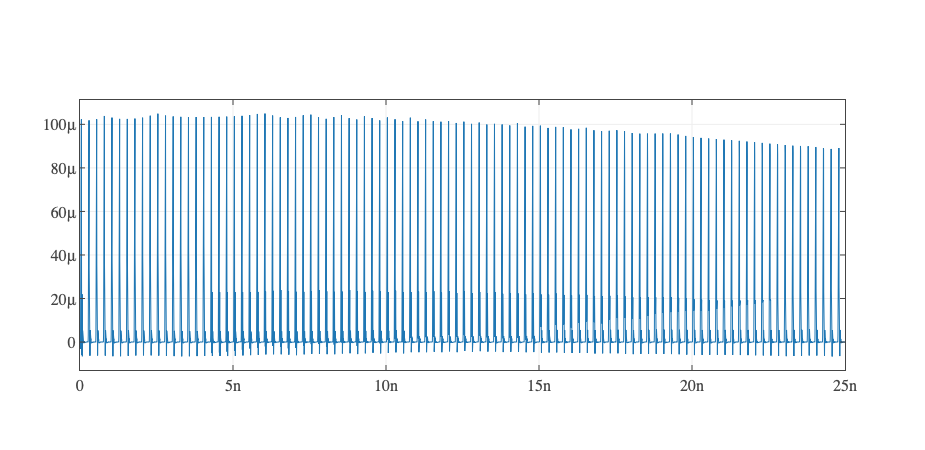

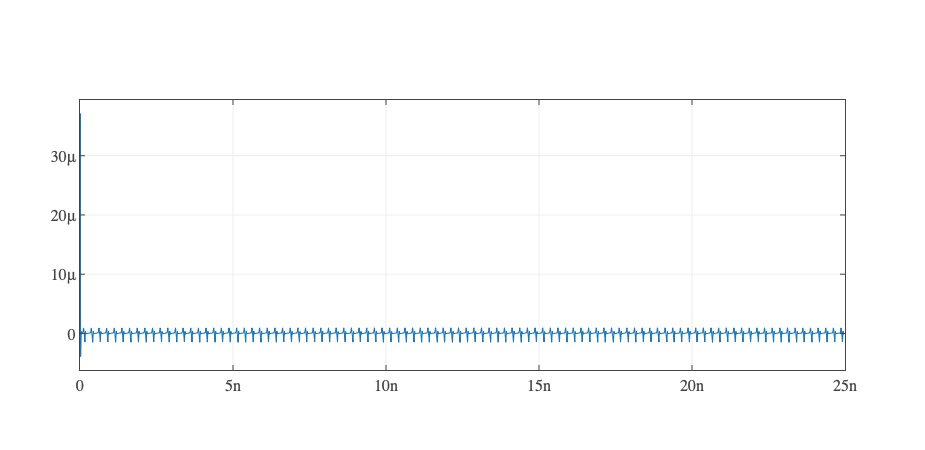

0.0013492356385749035

In [17]:
params = dict(jt=70, jb=70, jq=15, lc=20, k1=0.09, ib1=53.6, ib2=54.8)

find_switching_prob(params, 0, 87, plot=True)

## Gray Zone Calculations

Switching probability can be fit to Cummulative Distribution Function (integral of a gaussian)

$$
\DeclareMathOperator{\erf}{erf}
D(x) = \frac{1}{2} \left[ 1 + \erf{ \left( \frac{x - \mu}{\sigma\sqrt{2}} \right)}\right]
$$

In [19]:
from scipy.special import erf

def cdf(x, mu, std):
    
#     mu = P[0]
#     std = P[1]
    
    return 0.5 * (1 + erf((x - mu)/(std * np.sqrt(2))))

In [20]:
p, pcov = curve_fit(cdf, ixs, sps, p0=[-0.6, .1])

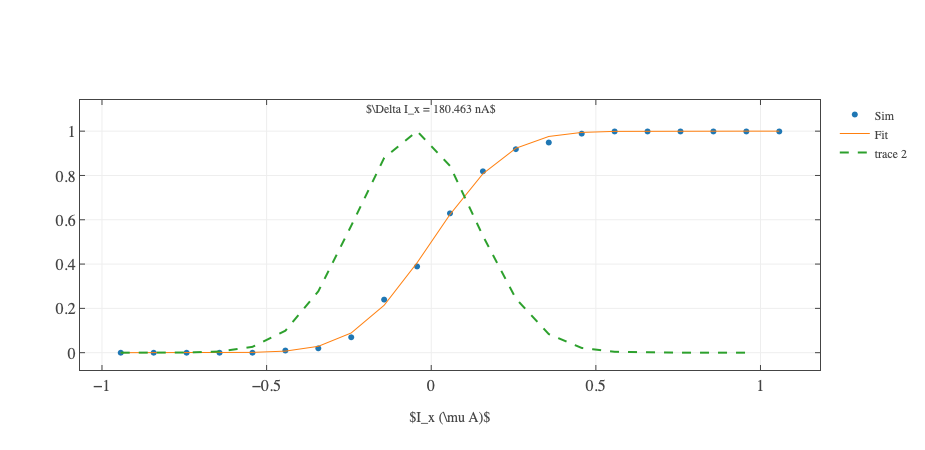

In [22]:
ix_mean, std = p[0], p[1]
fit = cdf(ixs, *p)

sim_tr = go.Scatter(x=ixs-ix_mean, y=sps, name='Sim', mode='markers')

layout, fit_tr = LinePlot(x=ixs-ix_mean, y=fit, show=False)

fit_tr.update(name='Fit')

deriv = np.diff(fit)
deriv_tr = go.Scatter(x=ixs-ix_mean, y=deriv/max(deriv), line={'dash': 'dash'})

layout.update(
    autosize=False, 
    xaxis={'title': '$I_x (\mu A)$'}, 
    annotations=[
        {'text': '$\Delta I_x = {:.3f} nA$'.format(p[1]*1000), 
         'showarrow': False, 
         'x': 0, 
         'y': 1.1}]
    )


iplot(go.Figure(data=[sim_tr, fit_tr, deriv_tr], layout=layout))

In [39]:
def gray_zone(params, iq):
    
    ixs = np.linspace(-1.6, 0.4, 51)
    sps = []


    for ix in tqdm.tqdm_notebook(ixs):
        sp = find_switching_prob(params, ix, iq)
        sps.append(1-sp)
        
    p, pcov = curve_fit(cdf, ixs, sps, p0=[np.mean(ixs), 2*iq])
    
    ix_mean, std = p[0], p[1]
    fit = cdf(ixs, *p)
    
    gz = np.sqrt(2*pi*std**2)

    sim_tr = go.Scatter(x=ixs-ix_mean, y=sps, name='Sim', mode='markers')

    layout, fit_tr = LinePlot(x=ixs-ix_mean, y=fit, show=False)

    fit_tr.update(name='Fit')

    deriv = np.diff(fit)
    deriv_tr = go.Scatter(x=ixs-ix_mean, y=deriv/max(deriv), name='dist', line={'dash': 'dash'})

    layout.update(
        autosize=False, 
        xaxis={'title': '$I_x (\mu A)$'}, 
        annotations=[
            {'text': 'Delta Ixjpm = {:.3f} nA'.format(gz*1000), 
             'showarrow': False, 
             'x': 0, 
             'y': 1.1}]
        )


    iplot(go.Figure(data=[sim_tr, fit_tr, deriv_tr], layout=layout))
    
    return gz

A Jupyter Widget

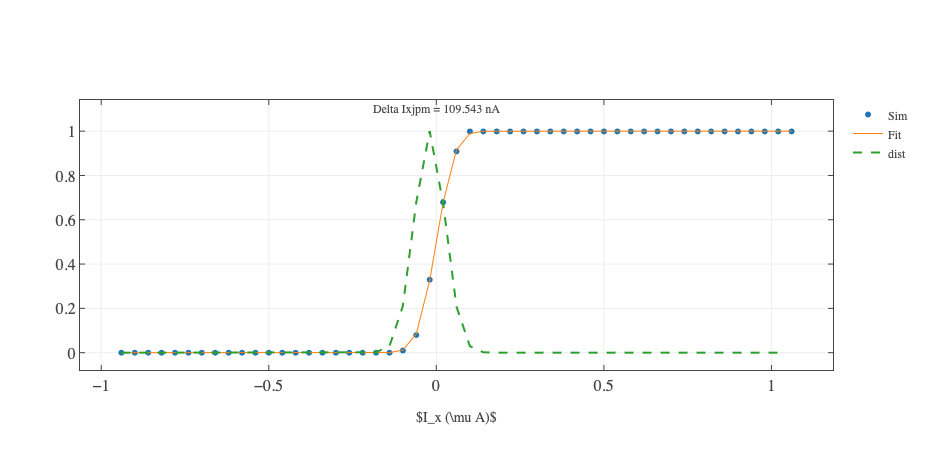

0.10954285941743816

In [46]:
gray_zone(params, 87)

# Full theory

In [259]:
# from sympy import *

Persistent current $J$

Bias current $I_b$

$$
J_b \sin{\phi_b} = (I_b + J)/2 \\
J_q \sin{\phi_q} = (I_b - J)/2 \\
\phi_b - \phi_q = \phi_x - \frac{2\pi}{\Phi_0}L J
$$

rearranging,

$$
\phi_b = \sin^{-1}{\left(\frac{I_b + J}{2J_b}\right)} \\
\phi_q = \sin^{-1}{\left(\frac{I_b - J}{2J_q}\right)} \\
J = \frac{\Phi_0}{2\pi L}(\phi_x - (\phi_b - \phi_q))
$$

Want to solve for 

In [257]:
from scipy.constants import e, h, hbar, pi

In [254]:
phi0 = h/(2*e)

In [240]:
x = symbols('x')
nsolve(sin(x)-x, x, 1)

0.000216176908232161

In [332]:
jb = 70e-6
jq = 15e-6
L = 20e-12


def funcs(var, ib, x):
    
    b, q, j = var
    
    return [
        b - np.arcsin((ib + j)/(2*jb)),
        q - np.arcsin((ib-j)/(2*jq)),
        j - phi0/(2*pi*L) * (x - (b - q))
    ]

In [333]:
x = 0.01 * 2*pi
ib = 0.5 * jq

sol = optimize.root(funcs, [pi, pi, 20e-6], args=(ib, x))

print("phi_b = {:.3f}".format(sol.x[0]))
print("phi_q = {:.3f}".format(sol.x[1]))
print("J = {:.3f} uA".format(sol.x[2] * 1e6))

phi_b = 0.072
phi_q = 0.165
J = 2.567 uA


/home/cjhowing/.conda/envs/caleb/lib/python3.6/site-packages/ipykernel/__main__.py:12: RuntimeWarning:

invalid value encountered in arcsin



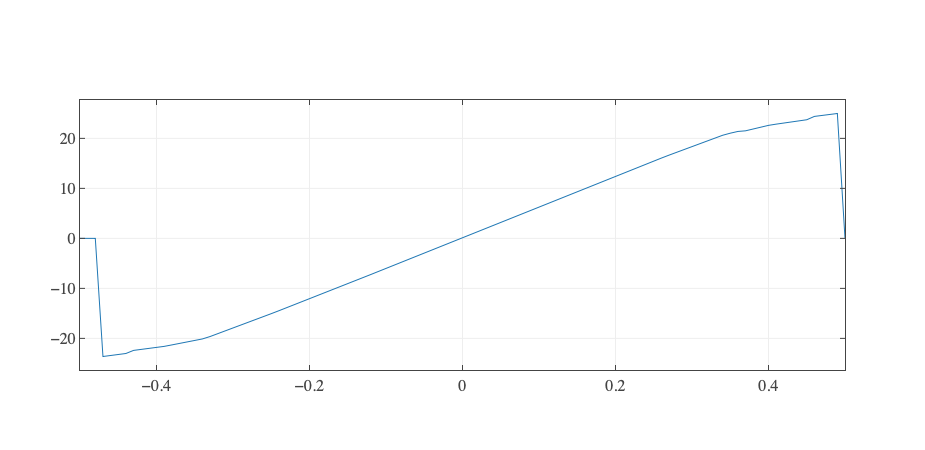

In [338]:
flux_ex = 0.5*np.linspace(-phi0, phi0, 101)

J = []

ib = 0.01*jb


for x in 2*pi*flux_ex/phi0:
    
    sol = optimize.root(funcs, [0, 0, 0], args=(ib, x))
    J.append(sol.x[2] * 1e6)
    
LinePlot(x=flux_ex/phi0, y=J);

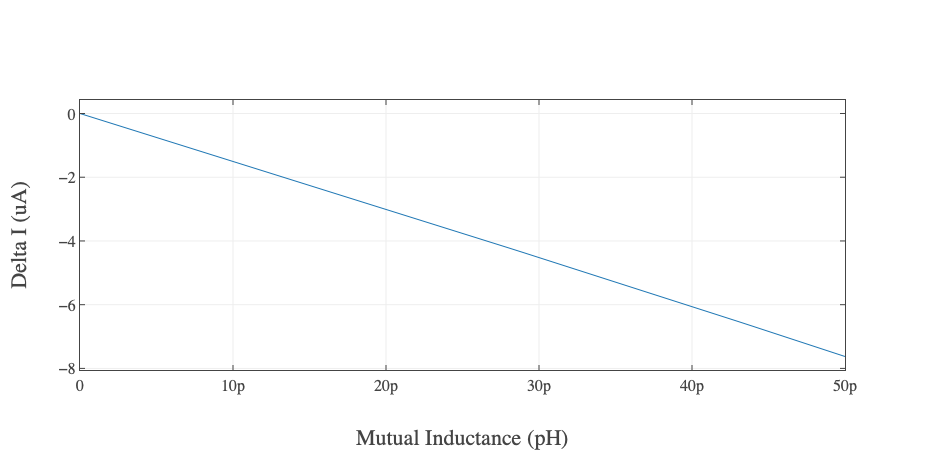

In [328]:
mutuals  = np.linspace(0, 50, 51)*1e-12 # 50pH
jpm_ic = 1e-6 # 1 uA

ib = 0

delta_i = []

for m in mutuals:
    phi_x = m * jpm_ic
    x = 2*pi*phi_x/phi0
    
    sol = optimize.root(funcs, [0, 0, 0], args=(ib, x))
    sol2 = optimize.root(funcs, [0, 0, 0], args=(ib, -x))
    
    delta_i.append(sol.x[2] - sol2.x[2]*1e6)
    
layout_opts = dict(xaxis=dict(title="Mutual Inductance (pH)"), yaxis=dict(title="Delta I (uA)"))
LinePlot(x=mutuals, y=delta_i, layoutOpts=layout_opts);

## Direct Potential

$$
U(x, y) = U_0 \left[ -s x - \cos{x}\cos{y} - \alpha \sin{x} \sin{y} - \eta s y + b(y - y_b)^2 \right]
$$

where 

$$
x = \phi_1 + \phi_2 \\
y = (\phi_1 - \phi_2)/2 \\
U_0 = \frac{2I_0 \Phi_0}{2\pi} \\
s = \frac{I_b}{2I_0} \\
\eta = -1 \\
b = \frac{\Phi_0}{2\pi L I_0} \\
y_b = \pi \frac{\Phi_x}{\Phi_0}
$$

In [314]:
def U_adc(x, y, args):
    
    U0 = 2*args['I0'] * phi0 / (2*pi)
    s  = args['Ib'] / (2 * args['I0'])
    b  = phi0 / (2 * pi * args['L'] * args['I0'])
    yb = pi * args['phix']
    
    return (-s * x - np.cos(x)*np.cos(y) - args['alpha']*np.sin(x)*np.sin(y) + s * y + b*(y - yb)**2)

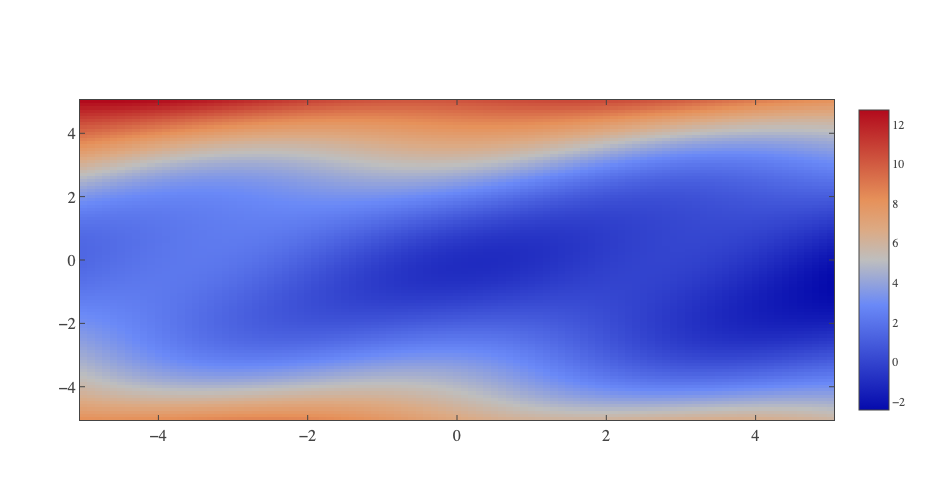

In [383]:
phis = np.linspace(-1, 1, 101)

args = dict(
    I0 = 42.85e-6,
    alpha = 0.65,
    L = 22e-12,
    phix = 0.005,
    Ib = 30e-6
)

x = 5*phis
y = x
X, Y = np.meshgrid(x, y)
U = U_adc(X, Y, args)
layout_opts = dict(height=500, width=500)
HeatmapPlot(x=x, y=y, z=U, layoutOpts=layout_opts);

J+: 0.000 uA 	 J-: 0.000 uA
J+: 0.000 uA 	 J-: 0.000 uA
J+: 4.283 uA 	 J-: 1.392 uA
J+: 4.283 uA 	 J-: 1.392 uA
J+: 4.283 uA 	 J-: 5.673 uA
J+: 8.556 uA 	 J-: 5.673 uA
J+: 8.556 uA 	 J-: 5.673 uA
J+: 8.556 uA 	 J-: 9.939 uA
J+: 12.807 uA 	 J-: 9.939 uA
J+: 12.807 uA 	 J-: 9.939 uA
J+: 14.180 uA 	 J-: 14.180 uA
J+: 14.180 uA 	 J-: 14.180 uA
J+: 14.180 uA 	 J-: 14.180 uA
J+: 18.385 uA 	 J-: 15.544 uA
J+: 18.385 uA 	 J-: 15.544 uA
J+: 18.385 uA 	 J-: 19.733 uA
J+: 22.545 uA 	 J-: 19.733 uA
J+: 22.545 uA 	 J-: 19.733 uA
J+: 22.545 uA 	 J-: 23.874 uA
J+: 26.648 uA 	 J-: 23.874 uA
J+: 26.648 uA 	 J-: 23.874 uA
J+: 27.954 uA 	 J-: 27.954 uA
J+: 27.954 uA 	 J-: 27.954 uA
J+: 27.954 uA 	 J-: 29.242 uA
J+: 31.965 uA 	 J-: 29.242 uA
J+: 31.965 uA 	 J-: 33.225 uA
J+: 31.965 uA 	 J-: 33.225 uA
J+: 35.896 uA 	 J-: 33.225 uA
J+: 35.896 uA 	 J-: 37.124 uA
J+: 39.737 uA 	 J-: 37.124 uA
J+: 39.737 uA 	 J-: 37.124 uA
J+: 40.930 uA 	 J-: 40.930 uA
J+: 40.930 uA 	 J-: 40.930 uA
J+: 44.634 uA 	 J-: 42.098 u

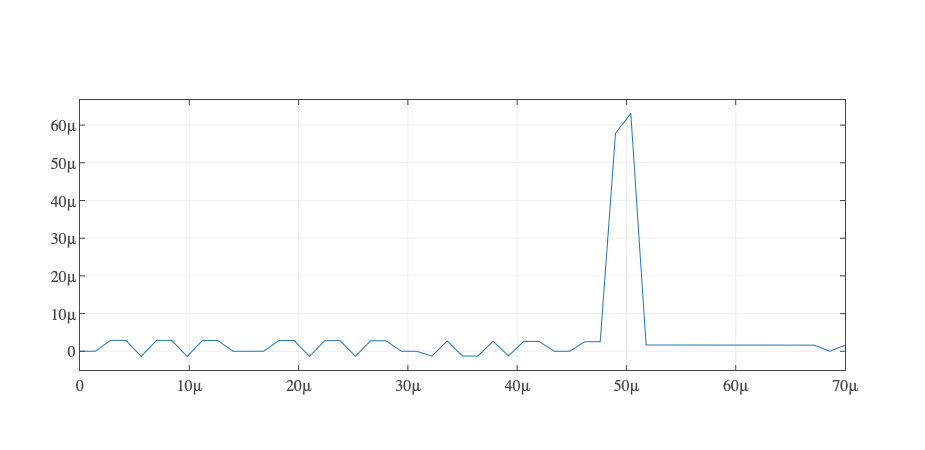

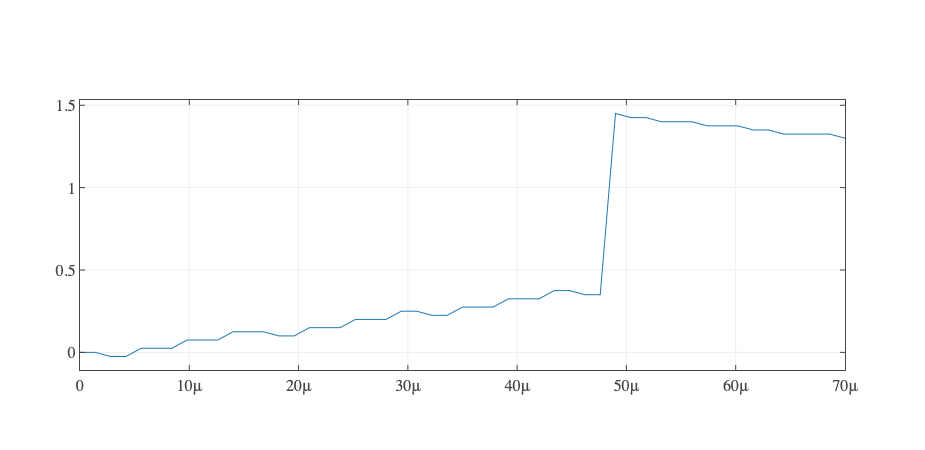

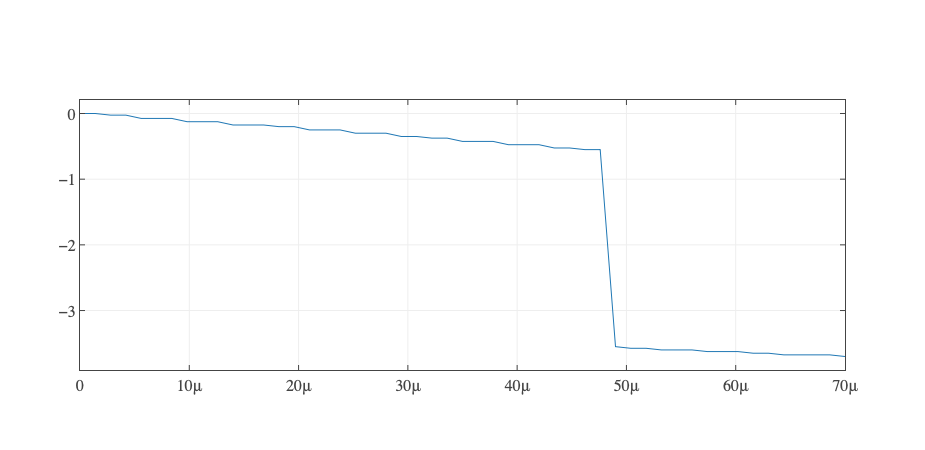

In [382]:
ibs = np.linspace(0, 70e-6, 51)

phix = 0.01

args = dict(
    I0 = 42.85e-6,
    alpha = 0.65,
    L = 22e-12,
    phix = 0.05,
    Ib = 30e-6
)

delta_js = []
phi1s = []
phi2s = []

for ib in ibs:
    args['Ib'] = ib
    args['phix'] = phix
    
    U = np.array(U_adc(X, Y, args))
    min_idx = np.unravel_index(U.argmin(), U.shape)
    
    x_min, y_min = x[min_idx[0]], y[min_idx[1]]
    
    phi1 = x_min/2 + y_min
    phi2 = x_min/2 - y_min
    
    j1 = args['I0'] * ((1-args['alpha']) * np.sin(phi1)  -   (1+args['alpha'])*np.sin(phi2))

    args['phix'] = -phix
    
    U = np.array(U_adc(X, Y, args))
    min_idx = np.unravel_index(U.argmin(), U.shape)
    
    x_min, y_min = x[min_idx[0]], y[min_idx[1]]
    
    phi1 = x_min/2 + y_min
    phi2 = x_min/2 - y_min
    
    j2 = args['I0'] * ((1-args['alpha']) * np.sin(phi1)  -   (1+args['alpha'])*np.sin(phi2))
    print("J+: {:.3f} uA \t J-: {:.3f} uA".format(j1*1e6, j2*1e6))
    
    delta_js.append(j1 - j2)
    phi1s.append(phi1)
    phi2s.append(phi2)
    
LinePlot(x=ibs, y=delta_js);
LinePlot(x=ibs, y=phi1s);
LinePlot(x=ibs, y=phi2s);

In [362]:
y_min

2.5